In [1]:
import pandas as pd
import os
import numpy as np
import matplotlib.pyplot as plt
from random import choice
import load_data

['fps-cycle_co-cheapest_insertion_mutation-50-0.8-0.05-True-False', 'fps-cycle_co-cheapest_insertion_mutation-2000-0.8-0.05-True-False']


['run-1621976943.csv', 'run-1621976836.csv']
['run-1621978080.csv']


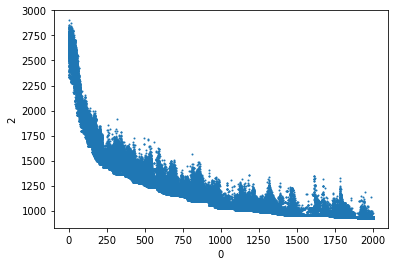

In [4]:
runs_path = "../runs/"
dirs = os.listdir(runs_path)

for dir in dirs:
    if dir == ".DS_Store":
        continue
    runs = os.listdir(runs_path + dir)
    print(runs)



# we want to evaluate all runs of one setup
dir = dirs[2]
runs = os.listdir(runs_path + dir)
best_fitness_list = []
best_fitness_serie = []

index = choice(range(len(runs)))
i = 0
for run in runs:
    df = pd.read_csv(runs_path + dir + "/" +run, header=None)

    # plot the best fitness across generations
    temp = np.asarray(df.groupby([0])[2].min())
    best_fitness_serie.append(temp)

    # find best fitness of last generation
    # make list of N final best fitnesses of each setup
    # compare average fitness,
    best = temp[-1]
    best_fitness_list.append(best)
    # plot all individuals fitness for each generation
    if i == 0:
        df = df.drop(columns=[1])
        df.plot.scatter(0, 2, s=1)

    i += 1
    #display(df)

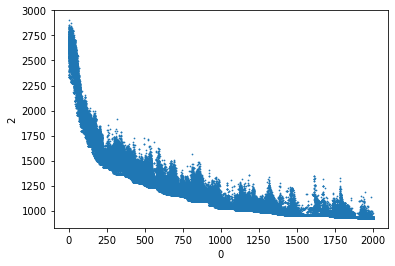

In [3]:
dir_index = 1
runs = load_data.get_run_paths(dir_index)
best_fitness_list = load_data.get_best_fitness_list(dir_index,runs)
best_fitness_serie = load_data.get_best_fitness_serie(dir_index, runs)
load_data.plot_whole_scatter(dir_index, 0, runs)

In [21]:
best_fitness_serie

[array([2423, 2390, 2387, 2387, 2321, 2321, 2321, 2321, 2321, 2321, 2321,
        2317, 2317, 2317, 2312, 2240, 2240, 2234, 2234, 2212, 2185, 2185,
        2185, 2185, 2169, 2169, 2167, 2145, 2145, 2145, 2145, 2125, 2032,
        2032, 2032, 2032, 2032, 2032, 2032, 2032, 2032, 2032, 2032, 1993,
        1993, 1993, 1993, 1993, 1993, 1993]),
 array([2158])]

Average best result: 2158.0


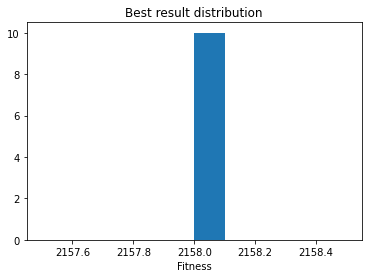

In [15]:
#actual plotting
print(f"Average best result: {np.mean(best_fitness_list)}")
plt.hist(best_fitness_list, density=True);
plt.title("Best result distribution");
plt.xlabel("Fitness");

/Users/ogame1997/.conda/envs/DataViz_PortugalCovidDashboard/lib/python3.7/site-packages/numpy/core/_asarray.py:171: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  return array(a, dtype, copy=False, order=order, subok=True)


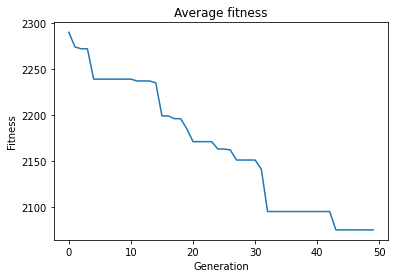

In [22]:
to_plot=np.mean(best_fitness_serie, axis=0)
plt.plot(range(len(to_plot)), to_plot);
plt.title("Average fitness");
plt.xlabel("Generation");
plt.ylabel("Fitness");

# WHEN SAVE ONLY LAST

In [17]:
runs_path = "../runs/"
dirs = os.listdir(runs_path)
#dirs.pop(0) in windows we don't have .DS_Store
for dir in dirs:
    if dir == ".DS_Store":
        continue
    runs = os.listdir(runs_path + dir)
    print(runs)

dir = dirs[1]
runs = os.listdir(runs_path + dir)
best_fitness_list = []
best_fitness_serie = []

i = 0
best = []
for run in runs:
    df = pd.read_csv(runs_path + dir + "/" +run, header=None)
    best.append(df[2].min())

['run-1621958471.csv', 'run-1621958593.csv']
['run-1621963983.csv', 'run-1621963995.csv', 'run-1621964005.csv', 'run-1621964008.csv', 'run-1621964010.csv', 'run-1621964013.csv']


Average performance:2059.6666666666665


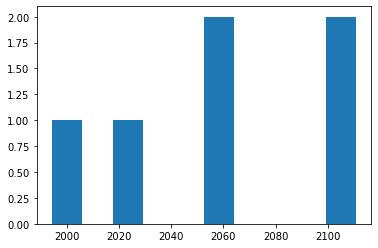

In [19]:
print(f"Average performance:{np.mean(best)}")
plt.hist(best);

In [ ]:
# to change in the setup: selection, crossover, mutation, elitism (always use elitism), prem (only fps)
# for each crossover we use fixed co_p (around 0.9)
# for each mutation we use fixed mu_p (e.g. swap 0.03, inversion 0.01)
# each run N times with M generations L individuals
# N = 50, M = 2000, L = 80
# make list of N final best fitnesses of each setup
# compare average fitness,

# treat multi objective fitness as an additional problem
# use best setting of first part